In [328]:
import os, glob, re, pickle
from functools import partial
from collections import OrderedDict
import operator as op
from cytoolz import compose
import loompy as lp
import pandas as pd
import seaborn as sns
import numpy as np
import scanpy as sc
import anndata as ad
import matplotlib as mpl
import matplotlib.pyplot as plt
from adjustText import adjust_text

from pyscenic.cli.utils import load_signatures

import loompy as lp
import json
import base64
import zlib
import re

from pyscenic.export import export2loom, add_scenic_metadata
from pyscenic.utils import load_motifs
from pyscenic.transform import df2regulons
from pyscenic.aucell import aucell
from pyscenic.binarization import binarize
from pyscenic.rss import regulon_specificity_scores
from pyscenic.plotting import plot_binarization, plot_rss

from IPython.display import HTML, display

In [332]:
BASE_URL = "https://plasmodb.org/a/images/pf_tfbs/"
COLUMN_NAME_LOGO = "MotifLogo"
COLUMN_NAME_MOTIF_ID = "MotifID"
COLUMN_NAME_TARGETS = "TargetGenes"

In [333]:
def display_logos(df: pd.DataFrame, top_target_genes: int = 3, base_url: str = BASE_URL):
    """
    :param df:
    :param base_url:
    """
    # Make sure the original dataframe is not altered.
    df = df.copy()
    
    # Add column with URLs to sequence logo.
    def create_url(motif_id):
        return '<img src="{}{}.png" style="max-height:124px;"></img>'.format(base_url, motif_id)
    df[("Enrichment", COLUMN_NAME_LOGO)] = list(map(create_url, df.index.get_level_values(COLUMN_NAME_MOTIF_ID)))
    
    # Truncate TargetGenes.
    def truncate(col_val):
        return sorted(col_val, key=op.itemgetter(1))[:top_target_genes]
    df[("Enrichment", COLUMN_NAME_TARGETS)] = list(map(truncate, df[("Enrichment", COLUMN_NAME_TARGETS)]))
    
    MAX_COL_WIDTH = pd.get_option('display.max_colwidth')
    pd.set_option('display.max_colwidth', -1)
    display(HTML(df.head().to_html(escape=False)))
    pd.set_option('display.max_colwidth', MAX_COL_WIDTH)

In [334]:
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()
sc.settings.set_figure_params(dpi=200)

In [363]:
RESOURCES_FOLDERNAME = "./"

In [364]:
#
#CELL_ANNOTATIONS_FNAME = os.path.join(RESOURCES_FOLDERNAME, "cells_metadata.csv")
#ANNDATA_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'for_shiny3d_v1.h5ad')
ANNDATA_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'Sc_10x_gams_anndata_updated_raw_test.h5ad')
#ANNDATA_FNAME_out = os.path.join(RESOURCES_FOLDERNAME, 'scenic_out_020223.h5ad.h5ad')
#REGULONS_DAT_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'regulons_v3.dat')
LOOM_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-10X_auc_mtx_new.loom')
MOTIFS_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-reg10x_new.csv')

In [381]:
REGULONS_DAT_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'regulons_new.dat')

In [248]:
BIN_MTX_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'new.bin.csv')
THR_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'new.thresholds.csv')
LOOM_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-10X_auc_mtx_new_forvis.loom')

In [451]:
LOOM_FNAME_out = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-10X_auc_mtx_new_forvis_mohammedetal_clusters.loom')

In [365]:
LOOM_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-10X_auc_mtx_new.loom')
#ad = sc.read_h5ad('for_shiny3d_SCENIC_out.h5ad')

In [54]:
ANNDATA_FNAME_out = os.path.join(RESOURCES_FOLDERNAME, 'for_shiny3d_SCENIC_out.h5ad')

In [401]:
adata = sc.read_h5ad(ANNDATA_FNAME)
#ad = sc.read_h5ad('scenic_out_020223.h5ad')

In [367]:
df_motifs = load_motifs(MOTIFS_FNAME)
df_motifs

Enrichment                                  \
                                  AUC       NES MotifSimilarityQvalue   
TF            MotifID                                                   
PF3D7_1305200 PFL1900w_DLD   0.057230  3.373064                   NaN   
PF3D7_1342900 PF11_0404_D1   0.053376  3.007152                   NaN   
PF3D7_0611200 PF11_0091      0.085316  3.076158                   NaN   
PF3D7_0613800 PFD0985w_D2    0.243966  3.107120                   NaN   
PF3D7_1342900 PFD0985w_D2    0.076756  3.353220                   NaN   
PF3D7_1350900 PFD0985w_D2    0.127202  3.095137                   NaN   
PF3D7_1429200 PFD0985w_D2    0.192651  3.183294                   NaN   
PF3D7_0604100 PF13_0267      0.045155  3.807602                   NaN   
PF3D7_1007700 PF11_0404_D1   0.028472  3.124811                   NaN   
              PF14_0079      0.030352  3.351737                   NaN   

                                                           \
                           OrthologousIdentity Annotation   
TF            MotifID                                       
PF3D7_1305200 PFL1900w_DLD                 NaN        NaN   
PF3D7_1342900 PF11_0404_D1                 NaN        NaN   
PF3D7_0611200 PF11_0091                    NaN        NaN   
PF3D7_0613800 PFD0985w_D2                  NaN        NaN   
PF3D7_1342900 PFD0985w_D2                  NaN        NaN   
PF3D7_1350900 PFD0985w_D2                  NaN        NaN   
PF3D7_1429200 PFD0985w_D2                  NaN        NaN   
PF3D7_0604100 PF13_0267                    NaN        NaN   
PF3D7_1007700 PF11_0404_D1                 NaN        NaN   
              PF14_0079                    NaN        NaN   

                                                                               \
                                                                      Context   
TF            MotifID                                                           
PF3D7_1305200 PFL1900w_DLD  (P.falciparum_v2_cis-targetdb.genes_vs_motifs....   
PF3D7_1342900 PF11_0404_D1  (weight>90.0%, P.falciparum_v2_cis-targetdb.ge...   
PF3D7_0611200 PF11_0091     (top20, P.falciparum_v2_cis-targetdb.genes_vs_...   
PF3D7_0613800 PFD0985w_D2   (top20, P.falciparum_v2_cis-targetdb.genes_vs_...   
PF3D7_1342900 PFD0985w_D2   (top20, P.falciparum_v2_cis-targetdb.genes_vs_...   
PF3D7_1350900 PFD0985w_D2   (top20, P.falciparum_v2_cis-targetdb.genes_vs_...   
PF3D7_1429200 PFD0985w_D2   (top20, P.falciparum_v2_cis-targetdb.genes_vs_...   
PF3D7_0604100 PF13_0267     (top20, repressing, P.falciparum_v2_cis-target...   
PF3D7_1007700 PF11_0404_D1  (top20, repressing, P.falciparum_v2_cis-target...   
              PF14_0079     (top20, repressing, P.falciparum_v2_cis-target...   

                                                                               \
                                                                  TargetGenes   
TF            MotifID                                                           
PF3D7_1305200 PFL1900w_DLD  [(PF3D7_0727600, 5.044761043085787), (PF3D7_02...   
PF3D7_1342900 PF11_0404_D1  [(PF3D7_1473700, 10.093860501499394), (PF3D7_1...   
PF3D7_0611200 PF11_0091     [(PF3D7_0903700, 9.920549717781595), (PF3D7_02...   
PF3D7_0613800 PFD0985w_D2   [(PF3D7_0314700, 62.144295014045184), (PF3D7_1...   
PF3D7_1342900 PFD0985w_D2   [(PF3D7_0314700, 29.538307521815018), (PF3D7_1...   
PF3D7_1350900 PFD0985w_D2   [(PF3D7_0314700, 18.081600218482038), (PF3D7_1...   
PF3D7_1429200 PFD0985w_D2   [(PF3D7_0314700, 30.58025367157283), (PF3D7_12...   
PF3D7_0604100 PF13_0267                                [(PF3D7_0604100, 1.0)]   
PF3D7_1007700 PF11_0404_D1               [(PF3D7_1310700, 15.56403103787168)]   
              PF14_0079     [(PF3D7_0306200, 17.491131647537227), (PF3D7_1...   

                                      \
                           RankAtMax   
TF            MotifID                  
PF3D7_1305200 PFL1900w_DLD        39   
PF3D7_1342900 P

In [368]:
display_logos(df_motifs.head())

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_55295/1961397235.py:20: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [369]:
display_logos(df_motifs_sel.sort_values([('Enrichment','NES')], ascending=False))

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_55295/1961397235.py:20: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [379]:
regulons_df = df2regulons(df_motifs)

Create regulons from a dataframe of enriched features.
Additional columns saved: []


In [382]:
# Pickle these regulons.
with open(REGULONS_DAT_FNAME, 'wb') as f:
    pickle.dump(regulons_df, f)

In [383]:
def fetch_logo(regulons_df, base_url = BASE_URL):
    for elem in regulons_df.context:
        if elem.endswith('.png'):
            return '<img src="{}{}" style="max-height:124px;"></img>'.format(base_url, elem)
    return ""

In [385]:
df_regulons = pd.DataFrame(data=[list(map(op.attrgetter('name'), regulons_df)),
                                 list(map(len, regulons_df)),
                                 list(map(fetch_logo, regulons_df))], index=['name', 'count', 'logo']).T

In [386]:
MAX_COL_WIDTH = pd.get_option('display.max_colwidth')
pd.set_option('display.max_colwidth', -1)
display(HTML(df_regulons.head().to_html(escape=False)))
pd.set_option('display.max_colwidth', MAX_COL_WIDTH)

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_55295/2364496528.py:2: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


,name,count,logo
0,PF3D7_0604100(-),1,
1,PF3D7_0611200(+),2,
2,PF3D7_0613800(+),7,
3,PF3D7_1007700(-),3,
4,PF3D7_1305200(+),2,


In [370]:
lf = lp.connect(LOOM_FNAME, mode='r', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID).T
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)

In [371]:
# create a dictionary of regulons:
regulons = {}
for i,r in pd.DataFrame(lf.ra.Regulons,index=lf.ra.Gene).iteritems():
    regulons[i] =  list(r[r==1].index.values)

In [372]:
sig = load_signatures('./SCENIC-reg10x_new.csv') 

Create regulons from a dataframe of enriched features.
Additional columns saved: []


In [390]:
#ad = add_scenic_metadata(adata, auc_mtx, sig)

In [402]:
ad_vis = add_scenic_metadata(adata, auc_mtx, regulons_df)

In [477]:
ad_vis

AnnData object with n_obs × n_vars = 4555 × 5019
    obs: 'n_genes', 'umi_counts', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4', 'clusters', 'S_score', 'G2M_score', 'phase', 'male_signature', 'female_signature', 'cell_class', 'annotation', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'imcs_score', 'Bulk_labels', 'pruned_labels', 'first_labels', 'Regulon(PF3D7_0604100(-))', 'Regulon(PF3D7_0611200(+))', 'Regulon(PF3D7_0613800(+))', 'Regulon(PF3D7_1007700(-))', 'Regulon(PF3D7_1305200(+))', 'Regulon(PF3D7_1342900(+))', 'Regulon(PF3D7_1350900(+))', 'Regulon(PF3D7_1429200(+))'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'hb', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Regulon(PF3D7_0604100(-))', 'Regulon(PF3D7_0611200(+))', 'Regulon(PF3D7_0613800(+))'

In [478]:
sc.tl.umap(ad_vis, n_components= 3, spread=0.9, min_dist= 0.9)

computing UMAP


/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)


In [405]:
embedding_pca_tsne = pd.DataFrame(ad_vis.obsm['X_tsne'], columns=[['_X', '_Y']], index=ad_vis.obs_names)

In [479]:
ad_vis.write_h5ad('scenic_out_for_vis_mohammedteal.h5ad')

In [408]:
embedding_aucell_tsne = pd.DataFrame(ad_vis.obsm['X_tsne'], columns=[['_X', '_Y']], index=ad_vis.obs_names)

In [409]:
ad_vis

AnnData object with n_obs × n_vars = 4555 × 5019
    obs: 'n_genes', 'umi_counts', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4', 'clusters', 'S_score', 'G2M_score', 'phase', 'male_signature', 'female_signature', 'cell_class', 'annotation', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'imcs_score', 'Bulk_labels', 'pruned_labels', 'first_labels', 'Regulon(PF3D7_0604100(-))', 'Regulon(PF3D7_0611200(+))', 'Regulon(PF3D7_0613800(+))', 'Regulon(PF3D7_1007700(-))', 'Regulon(PF3D7_1305200(+))', 'Regulon(PF3D7_1342900(+))', 'Regulon(PF3D7_1350900(+))', 'Regulon(PF3D7_1429200(+))'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'hb', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Regulon(PF3D7_0604100(-))', 'Regulon(PF3D7_0611200(+))', 'Regulon(PF3D7_0613800(+))'

In [17]:
selected_motifs = ['PF3D7_1305200','PF3D7_1342900','PF3D7_0611200']
df_motifs_sel = df_motifs.iloc[ [ True if x in selected_motifs else False for x in df_motifs.index.get_level_values('TF') ] ,:]

In [340]:
#display_logos(df_motifs.head())
display_logos( df_motifs_sel.sort_values([('Enrichment','NES')], ascending=False).head(20))

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_55295/1961397235.py:20: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [108]:
cellAnnot = ad.obs

In [109]:
rss_cellType = regulon_specificity_scores( auc_mtx, cellAnnot['cell_class'] )
rss_cellType

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
Early gametocyte,0.199771,0.254585,0.329582,0.174578,0.269935,0.502792,0.278141,0.249154
Male lineage,0.302084,0.179815,0.171692,0.167445,0.217188,0.249370,0.223448,0.181341
Female lineage,0.200294,0.278348,0.226117,0.260586,0.282527,0.289167,0.216608,0.226877


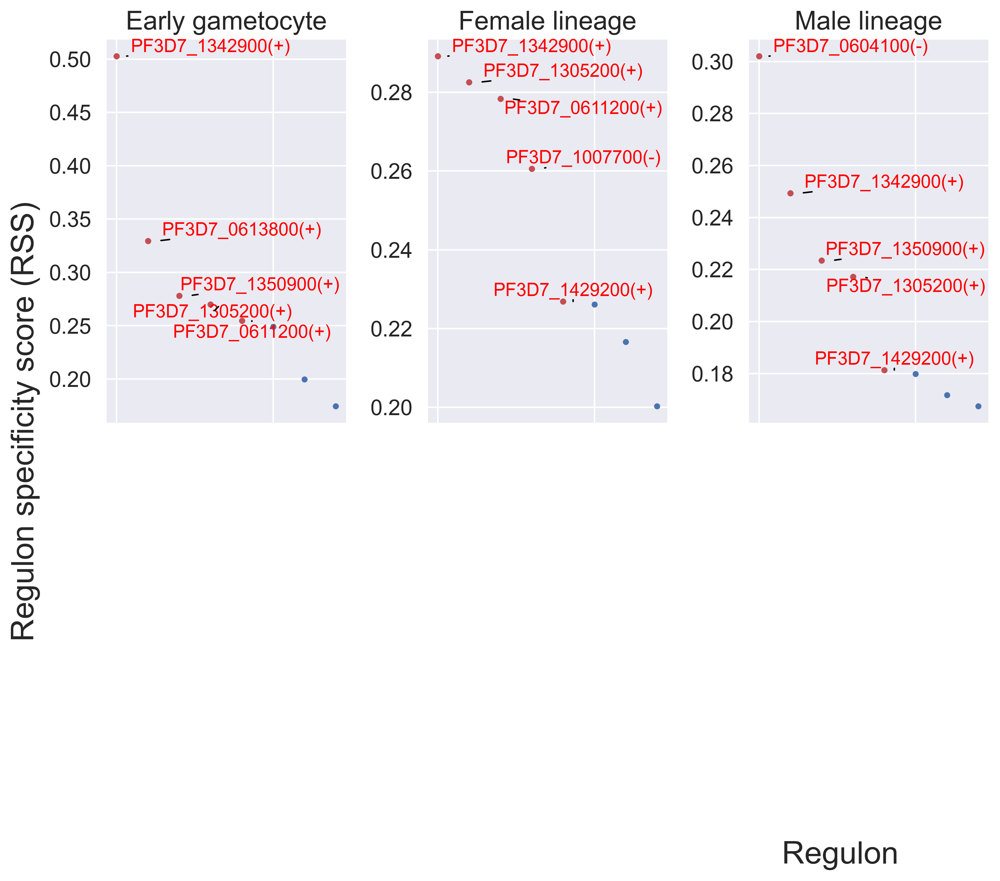

In [239]:
cats = sorted(list(set(cellAnnot['cell_class'])))

fig = plt.figure(figsize=(15, 8))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(2,5,num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='black'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
plt.savefig("sc10x_gams_cellType-RSS-top5.pdf", dpi=600, bbox_inches = "tight")
plt.show()

In [111]:
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_cellType.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))
topreg

['PF3D7_1350900(+)',
 'PF3D7_1007700(-)',
 'PF3D7_0611200(+)',
 'PF3D7_1305200(+)',
 'PF3D7_0604100(-)',
 'PF3D7_1342900(+)',
 'PF3D7_1429200(+)',
 'PF3D7_0613800(+)']

In [112]:
auc_mtx_Z = pd.DataFrame( index=auc_mtx.index )
for col in list(auc_mtx.columns):
    auc_mtx_Z[ col ] = ( auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0)
#auc_mtx_Z.sort_index(inplace=True)

In [157]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [158]:
colors = sns.color_palette('bright',n_colors=len(cats) )
colorsd = dict( zip( cats, colors ))
colormap = [ colorsd[x] for x in cellAnnot['cell_class'] ]

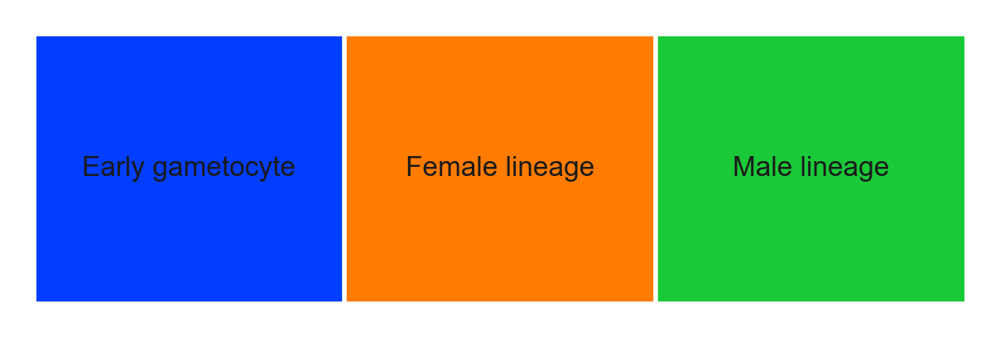

In [160]:
sns.set()
sns.set(font_scale=0.5)
fig = palplot( colors, cats, size=1.0)
#plt.savefig("PBMC10k_cellType-heatmap-legend-top5.pdf", dpi=600, bbox_inches = "tight")


In [162]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg].T, annot=False,  square=False,  linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-2, vmax=6, col_colors=colormap,
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')
#plt.savefig("PBMC10k_cellType-heatmap-top5.pdf", dpi=600, bbox_inches = "tight")

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, -393.6611111111112, '')

In [471]:
#meta_sub = df_metadata[["Barcode", "Bulk_labels"]]
#meta_sub.set_index('annotation')
#meta_sub
#meta_sub.to_csv('metadata_scope.csv', index=False)

In [138]:
N_COLORS = len(ad.obs.cell_class.dtype.categories)
#COLORS = [color['color'] for color in mpl.rcParams["axes.prop_cycle"]]
COLORS = ad.uns['cell_class_colors']

In [140]:
color_class = dict(zip(ad.obs.cell_class.dtype.categories, ad.uns['cell_class_colors']))
color_clusters = dict(zip(ad.obs.cell_class.dtype.categories, ad.uns['clusters_colors']))

In [456]:
#df_metadata = ad.obs
#df_metadata.to_csv('cells_metadata.csv')
#df_metadata = pd.read_csv('cells_metadata.csv')
df_metadata

,Barcode,n_genes,umi_counts,louvain_1.0,louvain_0.6,louvain_0.4,louvain_1.4,clusters,S_score,G2M_score,...,pruned_labels,first_labels,Regulon(PF3D7_0604100(-)),Regulon(PF3D7_0611200(+)),Regulon(PF3D7_0613800(+)),Regulon(PF3D7_1007700(-)),Regulon(PF3D7_1305200(+)),Regulon(PF3D7_1342900(+)),Regulon(PF3D7_1350900(+)),Regulon(PF3D7_1429200(+))
0,AAACCCAAGATGAATC-1,1340,2798.60820,0,0,0,7,0,-0.175439,-0.175439,...,II.Day5,II.Day5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,AAACCCAGTGAATAAC-1,1524,2994.50590,5,5,5,11,5,0.047093,0.047093,...,IV.Day9,IV.Day9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,AAACCCAGTGAATTAG-1,1298,2745.15400,5,5,5,11,5,-0.022611,-0.022611,...,IV.Day9,IV.Day9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,AAACCCATCCATCTAT-1,241,893.01843,8,1,1,10,8,-0.067437,-0.067437,...,IV.Day8,IV.Day8,0.000000,0.161355,0.000000,0.074369,0.000000,0.000000,0.000000,0.000000
4,AAACGAAAGGCGTCCT-1,1192,2590.70560,5,5,5,6,5,-0.199007,-0.199007,...,IV.Day9,II.III.Day6,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.290837,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4550,TTTGTTGGTAAGGCTG-1,1305,2757.71140,5,5,5,11,5,-0.119880,-0.119880,...,IV.Day9,II.III.Day6,0.800797,0.000000,0.000000,0.000000,0.486056,0.005662,0.000000,0.000000
4551,TTTGTTGGTCGGTGTC-1,808,2063.05400,0,0,0,2,0,-0.045277,-0.045277,...,II.III.Day6,II.III.Day6,0.000000,0.000000,0.000000,0.000000,0.000000,0.026001,0.321381,0.000000
4552,TTTGTTGGTCGTGGTC-1,686,1850.38290,6,3,3,5,6,-0.048457,-0.048457,...,II.III.Day6,II.Day5,0.000000,0.000000,0.062607,0.000000,0.000000,0.063116,0.000000,0.093227
4553,TTTGTTGGTGAGTTGG-1,1728,3202.45100,5,5,5,11,5,-0.009218,-0.009218,...,IV.Day9,IV.Day9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [142]:
#cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, COLORS))
cell_type_color_lut = dict(zip(ad.obs.cell_class.dtype.categories, ad.uns['cell_class_colors']))
cell_id2cell_type_lut = df_metadata.set_index('Barcode').cell_class.to_dict()
bw_palette = sns.xkcd_palette(["white", "black"])

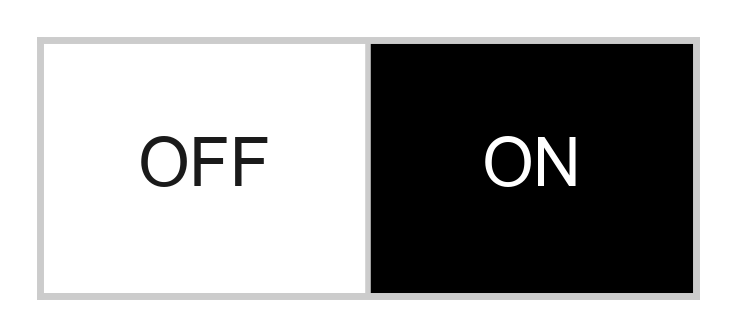

In [143]:
sns.set()
sns.set_style("whitegrid")
fig = palplot(bw_palette, ['OFF', 'ON'], ['k', 'w'])

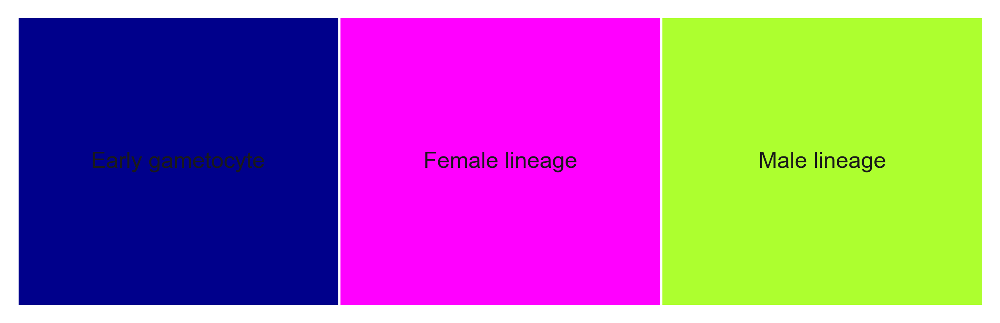

In [205]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot(sns.color_palette(COLORS), ad.obs.cell_class.dtype.categories, size=2)

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


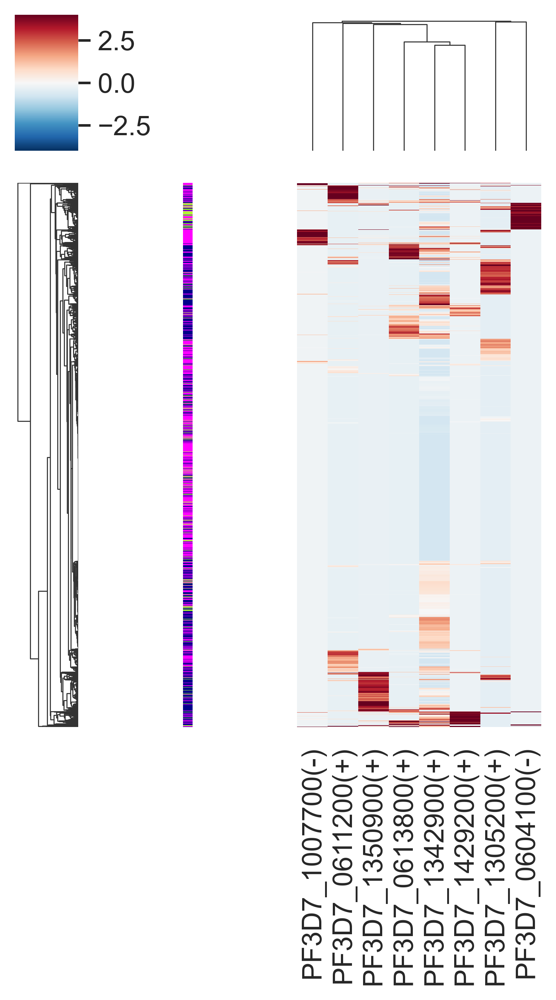

In [217]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg], annot=False,  square=False,  linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-4, vmax=4, row_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
    cmap="RdBu_r", figsize=(4,7) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')
plt.savefig("SC10xgams_cellType-heatmap-top8.png", dpi=800, bbox_inches = "tight")

In [149]:
binary_mtx, auc_thresholds = binarize( auc_mtx, num_workers=25 )
binary_mtx.head()

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
AAACCCAAGATGAATC-1,0,0,0,0,0,0,0,0
AAACCCAGTGAATAAC-1,0,0,0,0,0,0,0,0
AAACCCAGTGAATTAG-1,0,0,0,0,0,0,0,0
AAACCCATCCATCTAT-1,0,1,0,1,0,0,0,0
AAACGAAAGGCGTCCT-1,0,0,0,0,0,0,1,0


In [227]:
 r =  topreg
r

['PF3D7_1350900(+)',
 'PF3D7_1007700(-)',
 'PF3D7_0611200(+)',
 'PF3D7_1305200(+)',
 'PF3D7_0604100(-)',
 'PF3D7_1342900(+)',
 'PF3D7_1429200(+)',
 'PF3D7_0613800(+)']

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_55295/440720563.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(auc_mtx[ r[i] ], ax=ax, norm_hist=True, bins=10)
/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_55295/440720563.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.di

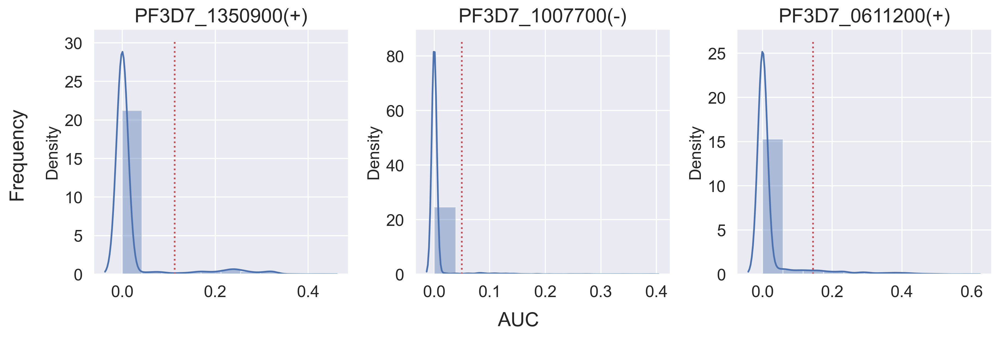

In [243]:
# select regulons:
r = [ 'PF3D7_1350900(+)', 'PF3D7_1007700(-)', 'PF3D7_0611200(+)', 'PF3D7_1305200(+)', 'PF3D7_0604100(-)' ]

    
fig, axs = plt.subplots(1, 3, figsize=(12, 4), dpi=150, sharey=False)
for i,ax in enumerate(axs):
    sns.distplot(auc_mtx[ r[i] ], ax=ax, norm_hist=True, bins=10)
    ax.plot( [ auc_thresholds[ r[i] ] ]*2, ax.get_ylim(), 'r:')
    ax.title.set_text( r[i] )
    ax.set_xlabel('')
    
fig.text(-0.01, 0.5, 'Frequency', ha='center', va='center', rotation='vertical', size='large')
fig.text(0.5, -0.01, 'AUC', ha='center', va='center', rotation='horizontal', size='large')

fig.tight_layout()
fig.savefig('PBMC10k_cellType-binaryPlot2.pdf', dpi=600, bbox_inches='tight')
#fig.savefig('PBMC10k_cellType-binaryPlot2.pdf', dpi=600, bbox_inches='tight')ype-binaryPlot2.pdf', dpi=600, bbox_inches='tight')

In [38]:
rss_louvain = regulon_specificity_scores( auc_mtx, cellAnnot['annotation'] )
rss_louvain

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
C0,0.180879,0.238118,0.215403,0.168505,0.245100,0.303588,0.251303,0.197959
C5,0.297661,0.175915,0.169596,0.167445,0.213980,0.240366,0.220631,0.174077
C8,0.167445,0.180915,0.175833,0.435791,0.211975,0.179480,0.169953,0.172495
C2,0.187738,0.229357,0.175472,0.167445,0.234167,0.223499,0.214388,0.173817
C3,0.182531,0.267658,0.303956,0.228007,0.200957,0.309819,0.239745,0.306543
C6,0.227412,0.193051,0.269116,0.197215,0.194625,0.289663,0.189680,0.269032
C4,0.179269,0.192126,0.324854,0.173135,0.212695,0.347121,0.219943,0.226467
C7,0.190180,0.204730,0.172926,0.182630,0.210246,0.187824,0.172834,0.168474
C9,0.187659,0.183585,0.187171,0.167445,0.209591,0.232106,0.221267,0.173827
C1,0.190826,0.224600,0.169305,0.191059,0.239968,0.188877,0.174574,0.170816


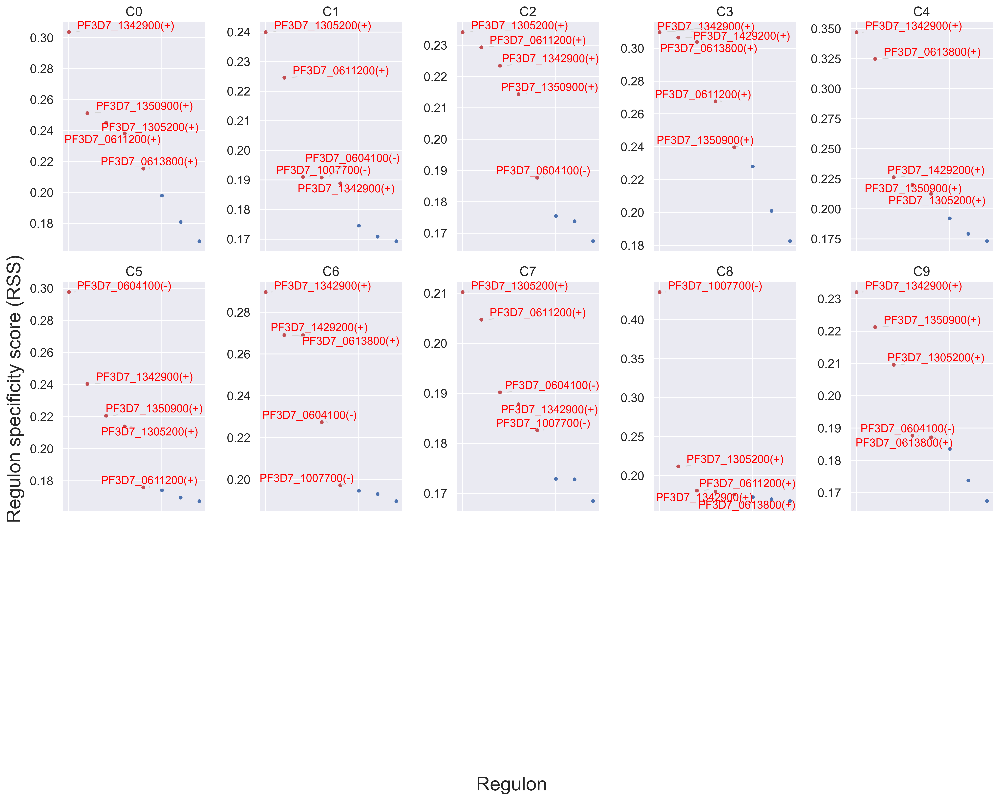

In [39]:
cats = sorted( list(set(cellAnnot['annotation'])) )

fig = plt.figure(figsize=(15, 12))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_louvain.T[c]
    ax = fig.add_subplot(3,5,num)
    plot_rss(rss_louvain, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='lightgrey'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
#plt.savefig("PBMC10k_Louvain-RSS-top5.png", dpi=150, bbox_inches = "tight")
plt.show()

In [40]:
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_louvain.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))
topreg

['PF3D7_1350900(+)',
 'PF3D7_1007700(-)',
 'PF3D7_0611200(+)',
 'PF3D7_1305200(+)',
 'PF3D7_0604100(-)',
 'PF3D7_1342900(+)',
 'PF3D7_1429200(+)',
 'PF3D7_0613800(+)']

In [41]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [42]:
colors = sns.color_palette('bright',n_colors=len(cats) )
colorsd = dict( zip( cats, colors ))
colormap = [ colorsd[x] for x in cellAnnot['annotation'] ]

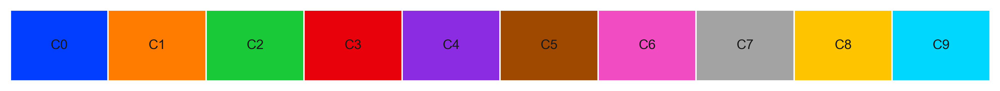

In [43]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot( colors, cats, size=1.0)

In [44]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg], annot=False,  square=False,  linecolor='gray',
    yticklabels=False, vmin=-2, vmax=6, row_colors=colormap,
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')    
g.ax_heatmap.set_xlabel('')  

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, 32.08888888888842, '')

In [252]:
bin_mtx, thresholds = binarize(auc_mtx)
bin_mtx.to_csv('./new.bin.csv')
thresholds.to_frame().rename(columns={0:'threshold'}).to_csv('./new.thr.csv')

In [413]:
DATASET_ID = "mohammedetalxxx"
TCGA_CODE = 'xxx'

In [420]:
regulons_df = [r.rename(r.name.replace('(',' (')) for r in regulons_df]

regulons_df

[Regulon(name='PF3D7_0604100 (-)', gene2weight=frozendict.frozendict({'PF3D7_0604100': 1.0}), gene2occurrence=frozendict.frozendict({}), transcription_factor='PF3D7_0604100', context=frozenset({'repressing', 'PF13_0267.png'}), score=3.8076019442675166, nes=0.0, orthologous_identity=0.0, similarity_qvalue=0.0, annotation=''),
 Regulon(name='PF3D7_0611200 (+)', gene2weight=frozendict.frozendict({'PF3D7_0903700': 9.920549717781595, 'PF3D7_0204900': 9.81656369550956}), gene2occurrence=frozendict.frozendict({}), transcription_factor='PF3D7_0611200', context=frozenset({'PF11_0091.png', 'activating'}), score=3.076157969184763, nes=0.0, orthologous_identity=0.0, similarity_qvalue=0.0, annotation=''),
 Regulon(name='PF3D7_0613800 (+)', gene2weight=frozendict.frozendict({'PF3D7_0314700': 62.144295014045184, 'PF3D7_1355700': 57.90951232877353, 'PF3D7_1236200': 95.31302986842236, 'PF3D7_0420300': 52.756147895282645, 'PF3D7_1420700': 62.58594333631308, 'PF3D7_1474000': 86.77319944968579, 'PF3D7_113

In [452]:
export2loom(ad_vis.to_df(), regulons_df, LOOM_FNAME_out,
            cell_annotations=ad_vis.obs['annotation'].to_dict(),
            embeddings=OrderedDict([('AUCell + tSNE', embedding_aucell_tsne), ('PCA + tSNE', embedding_pca_tsne)]),
            auc_mtx = auc_mtx,
            tree_structure=(),
            title='mohammedetal_dataset'.format(TCGA_CODE, DATASET_ID),
            nomenclature="PF3D7", auc_thresholds=thresholds,
            compress=True)

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


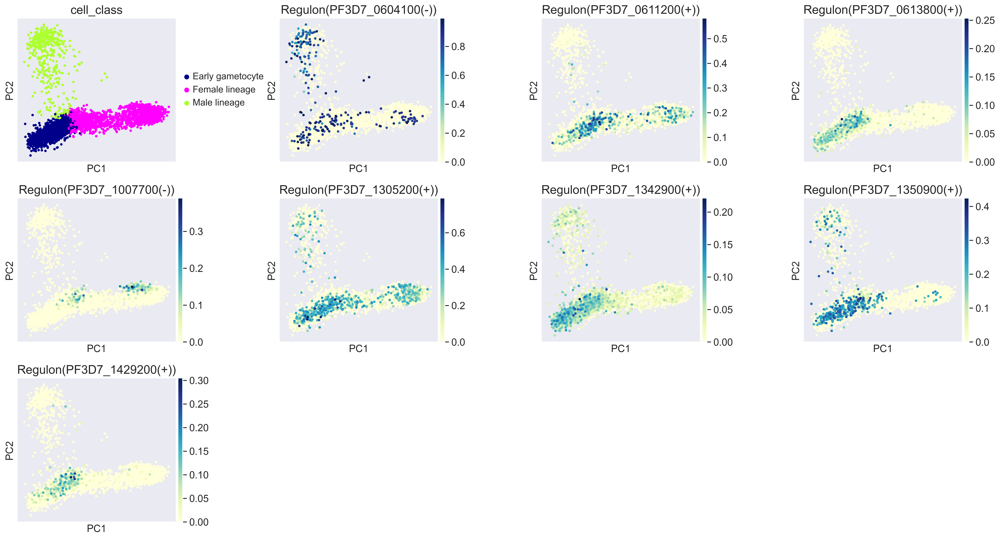

In [245]:
regs = ["cell_class", "Regulon(PF3D7_0604100(-))", "Regulon(PF3D7_0611200(+))","Regulon(PF3D7_0613800(+))", "Regulon(PF3D7_1007700(-))", "Regulon(PF3D7_1305200(+))",
       "Regulon(PF3D7_1342900(+))", "Regulon(PF3D7_1350900(+))", "Regulon(PF3D7_1429200(+))"]
sc.pl.pca(ad,color=regs, cmap='YlGnBu', size = 50, wspace=0.5) #save='regs_umap.png',

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_utils.py:288: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


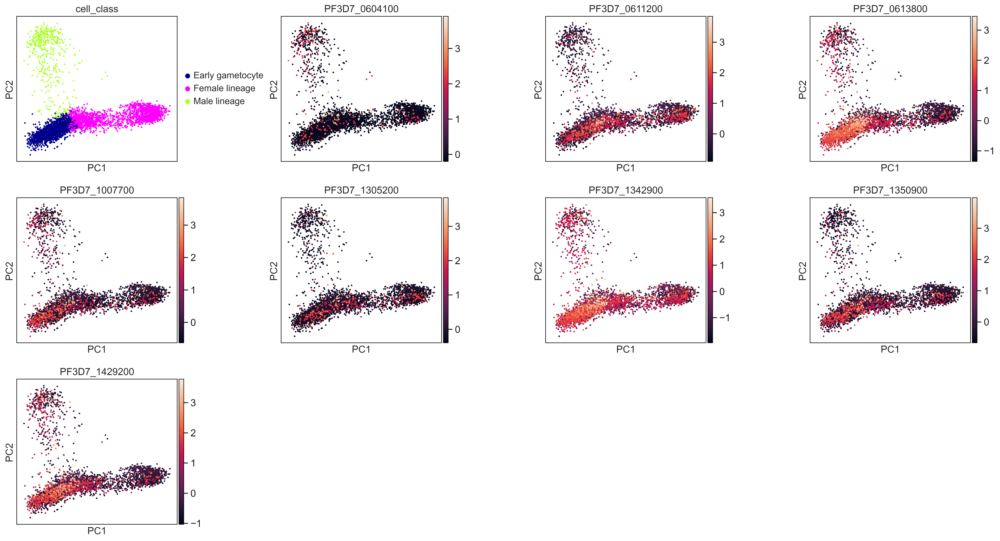

In [87]:
TFS = ["cell_class",'PF3D7_0604100', 'PF3D7_0611200', 'PF3D7_0613800', 'PF3D7_1007700', 'PF3D7_1305200', 'PF3D7_1342900', 'PF3D7_1350900', 'PF3D7_1429200']
sc.pl.pca(ad, color = TFS, size = 20, wspace=0.5, use_raw=False, save='TFs_pca.png')


In [447]:
ad_vis

AnnData object with n_obs × n_vars = 4555 × 5019
    obs: 'n_genes', 'umi_counts', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4', 'clusters', 'S_score', 'G2M_score', 'phase', 'male_signature', 'female_signature', 'cell_class', 'annotation', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'imcs_score', 'Bulk_labels', 'pruned_labels', 'first_labels', 'Regulon(PF3D7_0604100(-))', 'Regulon(PF3D7_0611200(+))', 'Regulon(PF3D7_0613800(+))', 'Regulon(PF3D7_1007700(-))', 'Regulon(PF3D7_1305200(+))', 'Regulon(PF3D7_1342900(+))', 'Regulon(PF3D7_1350900(+))', 'Regulon(PF3D7_1429200(+))'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'hb', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Regulon(PF3D7_0604100(-))', 'Regulon(PF3D7_0611200(+))', 'Regulon(PF3D7_0613800(+))'

In [ ]:
df_obs = ad.obs
signature_column_names = list(df_obs.select_dtypes('number').columns)
signature_column_names = list(filter(lambda s: s.startswith('Regulon('), signature_column_names))
df_scores = df_obs[signature_column_names + ['cell_class']]
df_results = ((df_scores.groupby(by='cell_class').mean() - df_obs[signature_column_names].mean())/ df_obs[signature_column_names].std()).stack().reset_index().rename(columns={'level_1': 'regulon', 0:'Z'})
df_results['regulon'] = list(map(lambda s: s[8:-1], df_results.regulon))
df_results[(df_results.Z >= 3.0)].sort_values('Z', ascending=False).head()

In [14]:
auc_mtx.head()

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
AAACCCAAGATGAATC-1,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0
AAACCCAGTGAATAAC-1,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0
AAACCCAGTGAATTAG-1,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0
AAACCCATCCATCTAT-1,0.0,0.161355,0.0,0.074369,0.0,0.0,0.000000,0.0
AAACGAAAGGCGTCCT-1,0.0,0.000000,0.0,0.000000,0.0,0.0,0.290837,0.0


In [15]:
lf.close()

In [16]:
adata = sc.read_h5ad(ANNDATA_FNAME) # read the anndata h5ad 

In [24]:
#Dont run if you used prepared object
old_to_new = {
'0':'C0',
'1':'C1',
'2':'C2',
'3':'C3',
'4':'C4',
'5':'C5',
'6':'C6',
'7':'C7',
'8':'C8',
'9':'C9',
}
adata.obs['annotation'] = (
adata.obs['clusters']
.map(old_to_new)
.astype('category')
)

In [25]:
#adata = adata[adata.obs['cell_class'].isin(['Differentiated female', 'Differentiated male', 'Early gametocyte', 'Mature female'])]
#adata.obs['cell_class'].cat.reorder_categories(['Early gametocyte', 'Differentiated female', 'Mature female', 'Differentiated male'], inplace = True)

/Users/mohammedmubasher/opt/anaconda3/envs/cellrank/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/Users/mohammedmubasher/opt/anaconda3/envs/cellrank/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)


/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


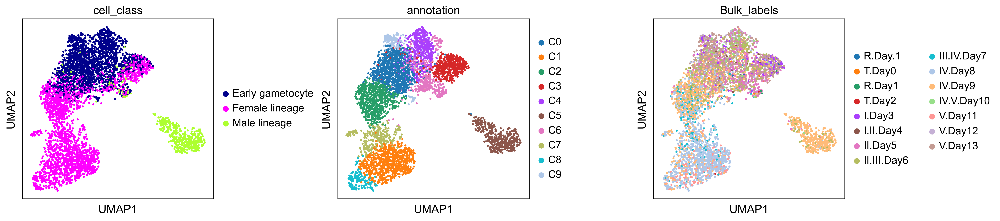

In [18]:
sc.pl.umap(adata, color =['cell_class', 'annotation', 'Bulk_labels'], wspace =0.5)

In [243]:
bin_mtx['cell_class'] = adata.obs['cell_class']
#bin_mtx['clusters'] = adata.obs['clusters']

In [244]:
auc_mtx

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
AAACCCAAGATGAATC-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCCAGTGAATAAC-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCCAGTGAATTAG-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCCATCCATCTAT-1,0.000000,0.161355,0.000000,0.074369,0.000000,0.000000,0.000000,0.000000
AAACGAAAGGCGTCCT-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.290837,0.000000
...,...,...,...,...,...,...,...,...
TTTGTTGGTAAGGCTG-1,0.800797,0.000000,0.000000,0.000000,0.486056,0.005662,0.000000,0.000000
TTTGTTGGTCGGTGTC-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.026001,0.321381,0.000000
TTTGTTGGTCGTGGTC-1,0.000000,0.000000,0.062607,0.000000,0.000000,0.063116,0.000000,0.093227
TTTGTTGGTGAGTTGG-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


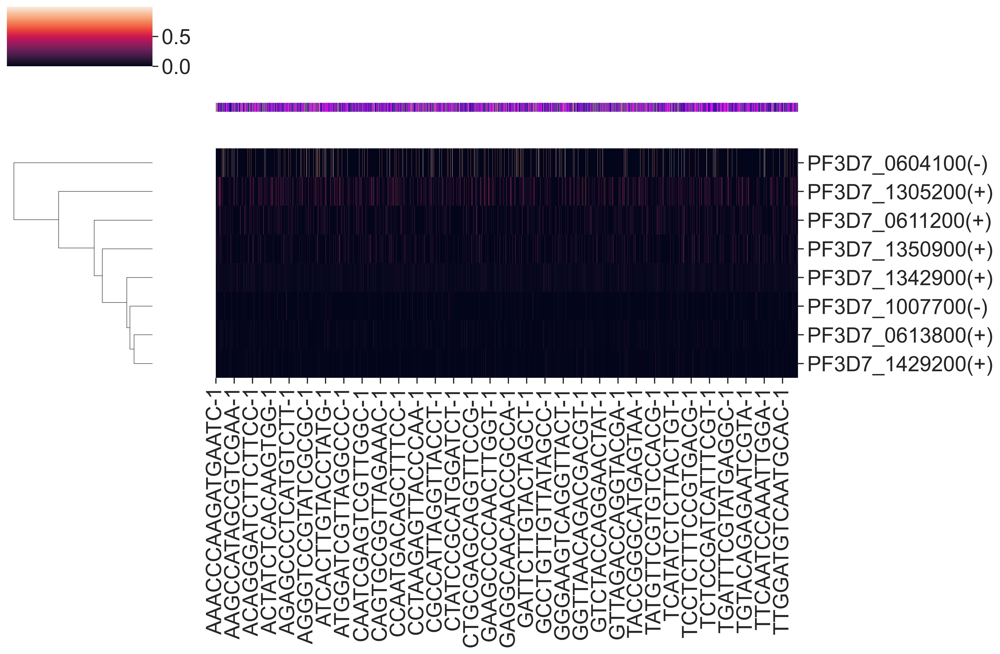

In [245]:
sns.clustermap(auc_mtx.T,col_cluster=False, row_cluster=True,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
                figsize=(15,10))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['Cell Class'])
g.cax.set_visible(False)

In [246]:
auc_mtx['cell_class'] = adata.obs['cell_class']

In [25]:
#bin_mtx.to_csv('bin_metadata.csv')

In [247]:
#get the thershold and the bin
auc_mtx_unsorted = auc_mtx
auc_mtx_unsorted['cell_class']=adata.obs['cell_class']
auc_mtx_unsorted.sort_values(by='cell_class', inplace=True)
auc_mtx=auc_mtx_unsorted.drop('cell_class', axis=1)
bin_mtx, thresholds = binarize(auc_mtx)

In [96]:
#bin_mtx, thresholds = binarize(auc_mtx)

In [24]:
bin_mtx.to_csv('bin_mtx.csv') # save things
thresholds.to_frame().rename(columns={0:'threshold'}).to_csv('thr_mtx.csv')
#thresholds

In [262]:
bin_mtx = pd.read_csv('./data_new/bin_mtx.csv', index_col=0)
thresholds = pd.read_csv('./data_new/thr_mtx.csv', index_col=0).threshold

/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/pyscenic/plotting.py:22: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(auc_mtx[regulon_name], ax=ax, norm_hist=True, bins=bins)
/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/pyscenic/plotting.py:22: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/

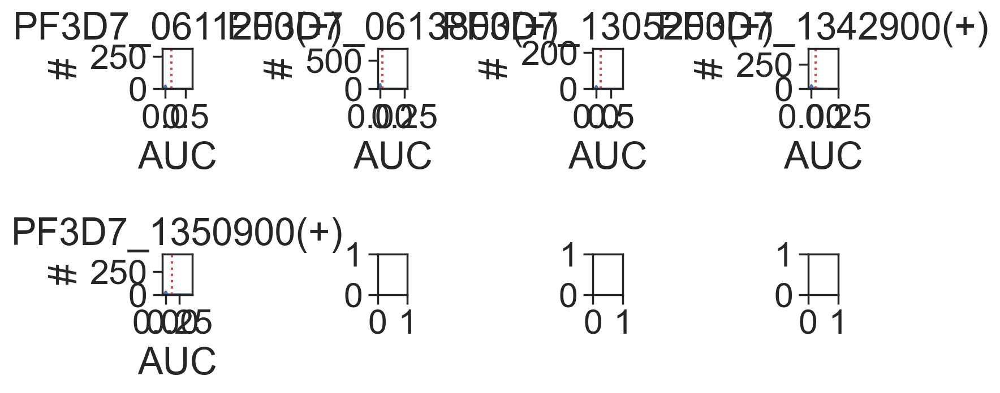

In [263]:
fig, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4, figsize=(8, 4), dpi=100)

plot_binarization(auc_mtx, 'PF3D7_0611200(+)', thresholds['PF3D7_0611200(+)'],ax=ax1)
plot_binarization(auc_mtx, 'PF3D7_0613800(+)', thresholds['PF3D7_0613800(+)'],ax=ax2)
plot_binarization(auc_mtx, 'PF3D7_1305200(+)', thresholds['PF3D7_1305200(+)'],ax=ax3)
plot_binarization(auc_mtx, 'PF3D7_1342900(+)', thresholds['PF3D7_1342900(+)'],ax=ax4)
plot_binarization(auc_mtx, 'PF3D7_1350900(+)', thresholds['PF3D7_1350900(+)'],ax=ax5)
plt.tight_layout() ## need some fixation could be unsorted auc_mtx

In [264]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [265]:
auc_mtx

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
AAACCCAAGATGAATC-1,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0
GATTGGTGTTGAAGTA-1,0.000000,0.000000,0.000000,0.0,0.000000,0.051373,0.000000,0.0
GATTGGTTCGTGGGTC-1,0.000000,0.125498,0.000000,0.0,0.000000,0.014049,0.000000,0.0
GATTTCTAGATCGACG-1,0.000000,0.000000,0.014229,0.0,0.000000,0.031243,0.000000,0.0
GCAACATAGTGGAAAG-1,0.000000,0.000000,0.000000,0.0,0.000000,0.049277,0.000000,0.0
...,...,...,...,...,...,...,...,...
CGGAACCCACTGCGAC-1,0.000000,0.000000,0.000000,0.0,0.278884,0.018033,0.000000,0.0
TCGGGACCAATTGCGT-1,0.741036,0.282869,0.000000,0.0,0.000000,0.017823,0.000000,0.0
TCGGGACGTCGAGCAA-1,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0
TCGGGCACACGACAAG-1,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0


In [266]:
N_COLORS = len(adata.obs.cell_class.dtype.categories)
#COLORS = [color['color'] for color in mpl.rcParams["axes.prop_cycle"]]
COLORS = adata.uns['cell_class_colors']

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


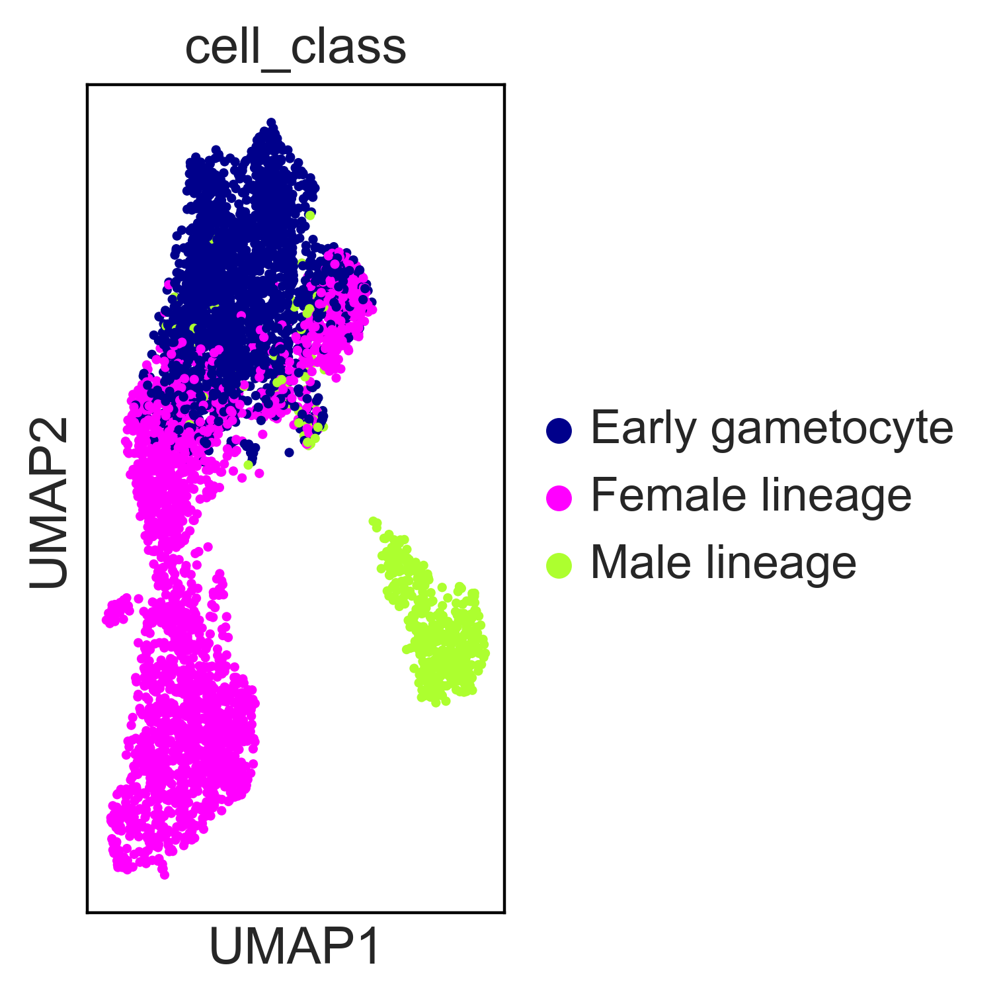

In [93]:
sc.pl.umap(ad, color=['cell_class'])

In [102]:
color_class = dict(zip(adata.obs.cell_class.dtype.categories, adata.uns['cell_class_colors']))
color_clusters = dict(zip(adata.obs.annotation.dtype.categories, adata.uns['annotation_colors']))

In [269]:
color_clusters

{'0': '#1f77b4',
 '1': '#ff7f0e',
 '2': '#279e68',
 '3': '#d62728',
 '4': '#aa40fc',
 '5': '#8c564b',
 '6': '#e377c2',
 '7': '#b5bd61',
 '8': '#17becf',
 '9': '#aec7e8'}

In [104]:
#auc_mtx_v1 = pd.read_csv('auc_mtx_v1.csv', index_col=0)

In [256]:
#df_metadata = pd.read_csv(CELL_ANNOTATIONS_FNAME, sep = ';')
df_metadata = pd.read_csv('./data_new/cells_metadata.csv')

In [140]:
df_metadata = adata.obs
#df_metadata.index.name = "Barcode"

In [142]:
#df_metadata.to_csv('./data_new/cells_metadata.csv')

In [270]:
df_metadata

,Barcode,n_genes,umi_counts,louvain_1.0,louvain_0.6,louvain_0.4,louvain_1.4,clusters,S_score,G2M_score,...,annotation,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,imcs_score
0,AAACCCAAGATGAATC-1,1340,2798.60820,0,0,0,7,0,-0.175439,-0.175439,...,C0,1340,2798.60820,0.0,0.0,0.0,0.0,0.0,0.0,0.088206
1,AAACCCAGTGAATAAC-1,1524,2994.50590,5,5,5,11,5,0.047093,0.047093,...,C5,1524,2994.50590,0.0,0.0,0.0,0.0,0.0,0.0,-0.228579
2,AAACCCAGTGAATTAG-1,1298,2745.15400,5,5,5,11,5,-0.022611,-0.022611,...,C5,1298,2745.15400,0.0,0.0,0.0,0.0,0.0,0.0,0.115212
3,AAACCCATCCATCTAT-1,241,893.01843,8,1,1,10,8,-0.067437,-0.067437,...,C8,241,893.01843,0.0,0.0,0.0,0.0,0.0,0.0,-0.001631
4,AAACGAAAGGCGTCCT-1,1192,2590.70560,5,5,5,6,5,-0.199007,-0.199007,...,C5,1192,2590.70560,0.0,0.0,0.0,0.0,0.0,0.0,-0.064071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4550,TTTGTTGGTAAGGCTG-1,1305,2757.71140,5,5,5,11,5,-0.119880,-0.119880,...,C5,1305,2757.71140,0.0,0.0,0.0,0.0,0.0,0.0,0.059067
4551,TTTGTTGGTCGGTGTC-1,808,2063.05400,0,0,0,2,0,-0.045277,-0.045277,...,C0,808,2063.05400,0.0,0.0,0.0,0.0,0.0,0.0,0.041830
4552,TTTGTTGGTCGTGGTC-1,686,1850.38290,6,3,3,5,6,-0.048457,-0.048457,...,C6,686,1850.38290,0.0,0.0,0.0,0.0,0.0,0.0,0.078010
4553,TTTGTTGGTGAGTTGG-1,1728,3202.45100,5,5,5,11,5,-0.009218,-0.009218,...,C5,1728,3202.45100,0.0,0.0,0.0,0.0,0.0,0.0,0.097129


In [96]:
cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, COLORS))
cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, adata.uns['cell_class_colors']))
#cell_id2cell_type_lut = df_metadata.set_index('Barcode').cell_class.to_dict()
bw_palette = sns.xkcd_palette(["white", "black"])

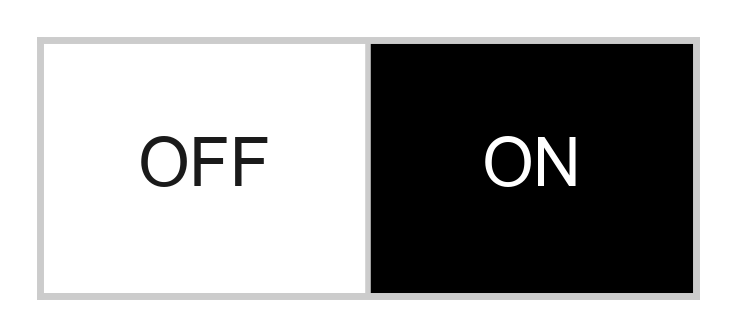

In [97]:
sns.set()
sns.set_style("whitegrid")
fig = palplot(bw_palette, ['OFF', 'ON'], ['k', 'w'])

In [103]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot(sns.color_palette(COLORS), adata.obs.cell_class.dtype.categories, size=2)

NameError: name 'COLORS' is not defined

/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


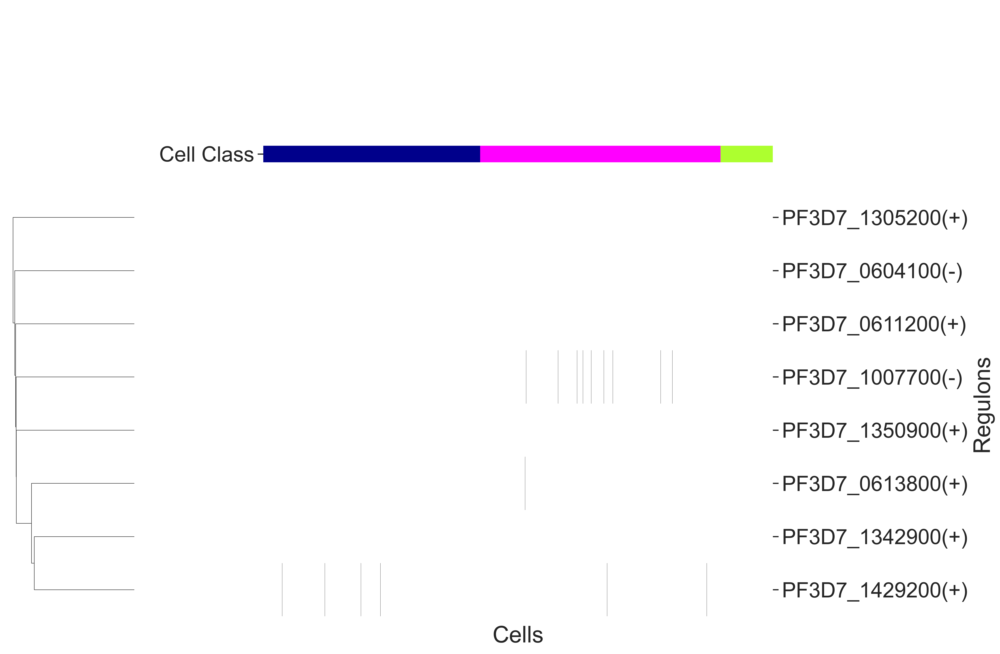

In [285]:
sns.set()
sns.set(font_scale=2.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(auc_mtx_Z.T, method="single", col_cluster=False, row_cluster=True,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(15,10))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['Cell Class'])
g.cax.set_visible(False)
#g.fig.savefig('clustermap - Regulons_V1.png', format='png')

/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


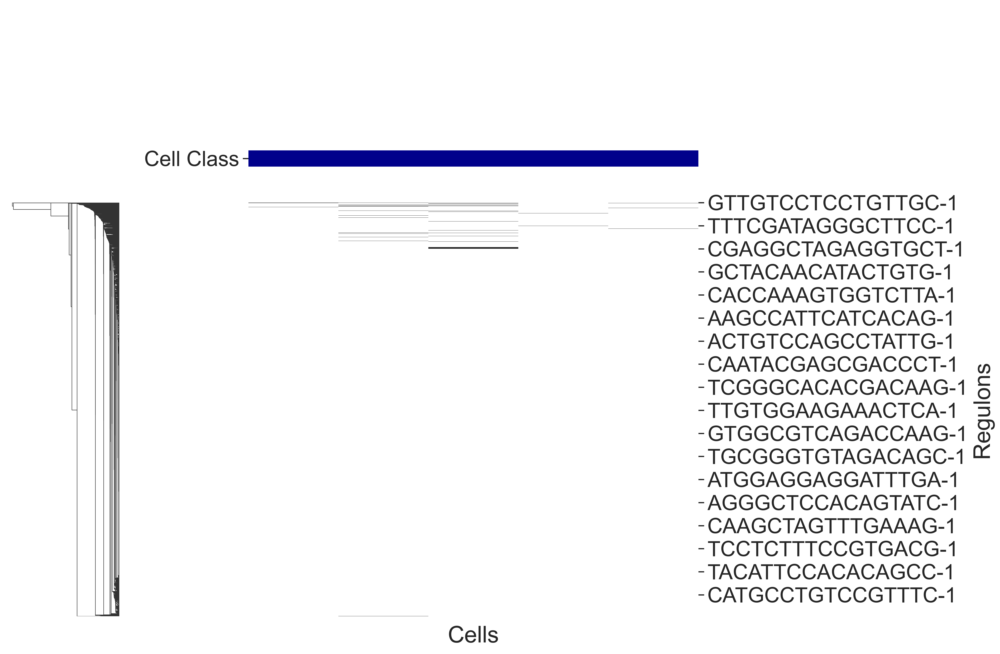

In [185]:
sns.set()
sns.set(font_scale=2.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(bin_mtx.T, method="single", col_cluster=False, row_cluster=True,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(15,10))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['Cell Class'])
g.cax.set_visible(False)
#g.fig.savefig('clustermap - Regulons_V2.png', format='png')

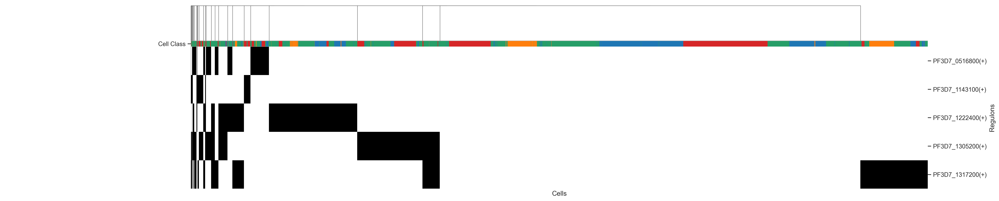

In [47]:
sns.set()
sns.set(font_scale=1.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(binary_mtx.T, method="single", col_cluster=True, row_cluster=False, 
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(25,7))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['Cell Class'])
g.cax.set_visible(False)
#g.fig.savefig('clustermap - Regulons_V2.png', format='png')

In [275]:
rss_cellType = regulon_specificity_scores(auc_mtx, adata.obs.cell_class)
rss_cellType

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
Early gametocyte,0.223661,0.256256,0.258462,0.214958,0.274475,0.379790,0.250522,0.232212
Male lineage,0.191876,0.210140,0.215994,0.185910,0.216497,0.245515,0.206104,0.199386
Female lineage,0.217928,0.262440,0.268508,0.213435,0.278085,0.390621,0.248586,0.234750


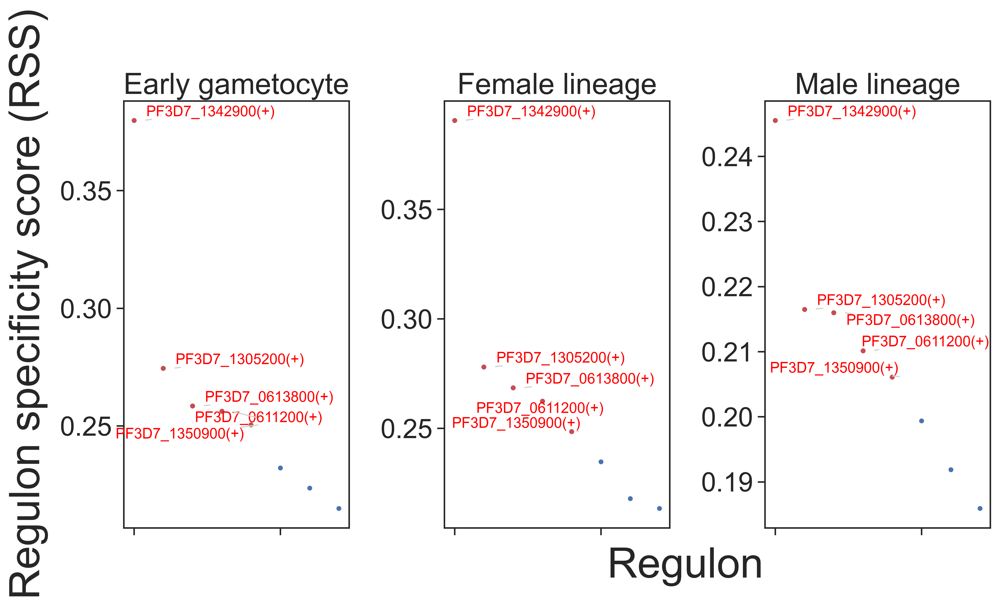

In [276]:
cats = sorted(list(set(adata.obs.cell_class)))

fig = plt.figure(figsize=(15, 6))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(1,4,num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='lightgrey'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
#fig.savefig("RSS_score.png")

In [277]:
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_cellType.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))

In [278]:
topreg

['PF3D7_1350900(+)',
 'PF3D7_0613800(+)',
 'PF3D7_0611200(+)',
 'PF3D7_1342900(+)',
 'PF3D7_1305200(+)']

In [279]:
auc_mtx_Z = pd.DataFrame( index=auc_mtx.index )
for col in list(auc_mtx.columns):
    auc_mtx_Z[ col ] = ( auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0)
#auc_mtx_Z.sort_index(inplace=True)

In [280]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [281]:
#cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, COLORS))
cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, adata.uns['cell_class_colors']))
cell_id2cell_type_lut = df_metadata.set_index('Barcode').cell_class.to_dict()
bw_palette = sns.xkcd_palette(["white", "black"])

In [117]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot(sns.color_palette(COLORS), adata.obs.cell_class.dtype.categories, size=2)

NameError: name 'COLORS' is not defined

In [202]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg], annot=False,  square=False,  linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-2, vmax=6, row_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')
#plt.savefig("PBMC10k_cellType-heatmap-top5.pdf", dpi=600, bbox_inches = "tight")

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, 32.08888888888842, '')

In [186]:
binary_mtx, auc_thresholds = binarize( auc_mtx, num_workers=25 )
binary_mtx.head()

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
AAACCCAAGATGAATC-1,0,0,0,0,0,0,0,0
TATTCCACAGGTTACT-1,0,0,0,0,0,0,0,0
TATTCCAAGCGATTCT-1,0,1,0,0,0,1,0,0
TATGTTCTCCAGCTCT-1,0,0,1,0,0,0,0,0
TATGTTCGTGTCCACG-1,0,0,0,0,0,0,0,0


/var/folders/h5/cwp4w7cd35554f006psf_z9w0000gn/T/ipykernel_5354/3246400053.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(auc_mtx[ r[i] ], ax=ax, norm_hist=True, bins=100)
/var/folders/h5/cwp4w7cd35554f006psf_z9w0000gn/T/ipykernel_5354/3246400053.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.d

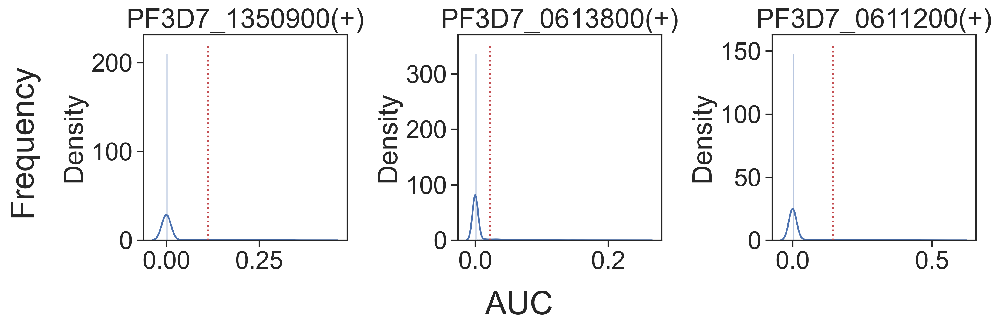

In [188]:
r = [ 'PF3D7_1350900(+)', 'PF3D7_0613800(+)', 'PF3D7_0611200(+)' ]

fig, axs = plt.subplots(1, 3, figsize=(12, 4), dpi=150, sharey=False)
for i,ax in enumerate(axs):
    sns.distplot(auc_mtx[ r[i] ], ax=ax, norm_hist=True, bins=100)
    ax.plot( [ auc_thresholds[ r[i] ] ]*2, ax.get_ylim(), 'r:')
    ax.title.set_text( r[i] )
    ax.set_xlabel('')
    
fig.text(-0.01, 0.5, 'Frequency', ha='center', va='center', rotation='vertical', size='large')
fig.text(0.5, -0.01, 'AUC', ha='center', va='center', rotation='horizontal', size='large')

fig.tight_layout()
#fig.savefig('PBMC10k_cellType-binaryPlot2.pdf', dpi=600, bbox_inches='tight')

In [261]:
adjacencies = pd.read_csv("grn_adj_new.csv", index_col=False)

In [260]:
from pyscenic.utils import modules_from_adjacencies


In [262]:
regulons = {}
for i,r in pd.DataFrame(lf.ra.Regulons,index=lf.ra.Gene).iteritems():
    regulons[i] =  list(r[r==1].index.values)

In [263]:
regulons

{'PF3D7_0604100(-)': ['PF3D7_0604100'],
 'PF3D7_0611200(+)': ['PF3D7_0903700', 'PF3D7_0204900'],
 'PF3D7_0613800(+)': ['PF3D7_1420700',
  'PF3D7_1474000',
  'PF3D7_1355700',
  'PF3D7_1236200',
  'PF3D7_1138400',
  'PF3D7_0420300',
  'PF3D7_0314700'],
 'PF3D7_1007700(-)': ['PF3D7_1466500', 'PF3D7_1310700', 'PF3D7_0306200'],
 'PF3D7_1305200(+)': ['PF3D7_0727600', 'PF3D7_0219100'],
 'PF3D7_1342900(+)': ['PF3D7_1407800',
  'PF3D7_1408100',
  'PF3D7_1420700',
  'PF3D7_1429200',
  'PF3D7_1433700',
  'PF3D7_1442600',
  'PF3D7_1444100',
  'PF3D7_1473700',
  'PF3D7_1474000',
  'PF3D7_1476500',
  'PF3D7_1333200',
  'PF3D7_1229100',
  'PF3D7_1122900',
  'PF3D7_1126000',
  'PF3D7_1131400',
  'PF3D7_1147300',
  'PF3D7_0914500',
  'PF3D7_0817300',
  'PF3D7_0314700'],
 'PF3D7_1350900(+)': ['PF3D7_1121600', 'PF3D7_0810800', 'PF3D7_0314700'],
 'PF3D7_1429200(+)': ['PF3D7_1420700',
  'PF3D7_1429200',
  'PF3D7_1444100',
  'PF3D7_1236200',
  'PF3D7_0314700']}

In [264]:
exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID).T

In [265]:
modules = list(modules_from_adjacencies(adjacencies, exprMat))


2023-02-03 09:34:33,288 - pyscenic.utils - INFO - Calculating Pearson correlations.

2023-02-03 09:34:33,314 - pyscenic.utils - WARNING - Note on correlation calculation: the default behaviour for calculating the correlations has changed after pySCENIC verion 0.9.16. Previously, the default was to calculate the correlation between a TF and target gene using only cells with non-zero expression values (mask_dropouts=True). The current default is now to use all cells to match the behavior of the R verision of SCENIC. The original settings can be retained by setting 'rho_mask_dropouts=True' in the modules_from_adjacencies function, or '--mask_dropouts' from the CLI.
	Dropout masking is currently set to [False].

2023-02-03 09:34:35,602 - pyscenic.utils - INFO - Creating modules.


In [ ]:
'PF3D7_0604100', 'PF3D7_0611200', 'PF3D7_0613800', 'PF3D7_1007700', 'PF3D7_1305200', 'PF3D7_1342900', 'PF3D7_1350900', 'PF3D7_1429200'

In [274]:
tf = 'PF3D7_0613800'
tf_mods = [ x for x in modules if x.transcription_factor==tf ]

for i,mod in enumerate( tf_mods ):
    print( f'{tf} module {str(i)}: {len(mod.genes)} genes' )
print( f'{tf} regulon: {len(regulons[tf+"(+)"])} genes' )

PF3D7_0613800 module 0: 924 genes
PF3D7_0613800 module 1: 621 genes
PF3D7_0613800 module 2: 51 genes
PF3D7_0613800 module 3: 1404 genes
PF3D7_0613800 module 4: 1585 genes
PF3D7_0613800 module 5: 1601 genes
PF3D7_0613800 regulon: 7 genes


In [276]:
for i,mod in enumerate( tf_mods ):
    with open( tf+'_module_'+str(i)+'.txt', 'w') as f:
        for item in mod.genes:
            f.write("%s\n" % item)
            
with open( tf+'_regulon.txt', 'w') as f:
    for item in regulons[tf+'(+)']:
        f.write("%s\n" % item)

In [283]:
with open("TFs2targets.txt", "w") as output:
    output.write(str(regulons))

In [285]:
regulons = [r.rename(r.name.replace('(+)',' ('+str(len(r))+'g)')) for r in regulons]
regulons

AttributeError: 'str' object has no attribute 'rename'

In [286]:
export2loom(ad.to_df(), regulons, LOOM_FNAME,
            cell_annotations=ad.obs['cell_class'].to_dict(),
            auc_mtx = auc_mtx,
            tree_structure=(),
            nomenclature="Single_cell-gametocyte", auc_thresholds=thresholds,
            compress=False)

KeyError: 0

In [281]:
thresholds

PF3D7_0604100(-)    0.196560
PF3D7_0611200(+)    0.145083
PF3D7_0613800(+)    0.022346
PF3D7_1007700(-)    0.049519
PF3D7_1305200(+)    0.153942
PF3D7_1342900(+)    0.037944
PF3D7_1350900(+)    0.112827
PF3D7_1429200(+)    0.037651
dtype: float64

In [52]:
with open("TFs2targets.txt", "w") as output:
    output.write(str(regulons))

In [55]:
adata.write_h5ad(ANNDATA_FNAME_out)

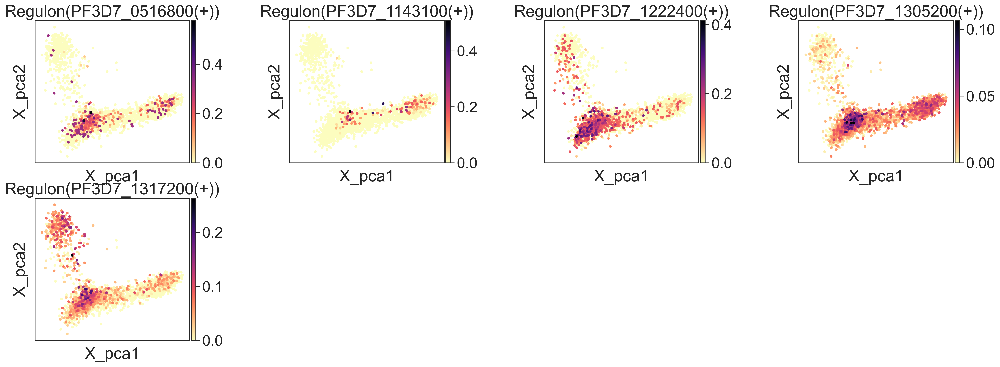

In [218]:
regs = ["Regulon(PF3D7_0516800(+))","Regulon(PF3D7_1143100(+))","Regulon(PF3D7_1222400(+))","Regulon(PF3D7_1305200(+))", "Regulon(PF3D7_1317200(+))"]
sc.pl.embedding(ad,"X_pca",color=regs, cmap='magma_r', size = 60, wspace=0.5) #save='regs_umap.png',

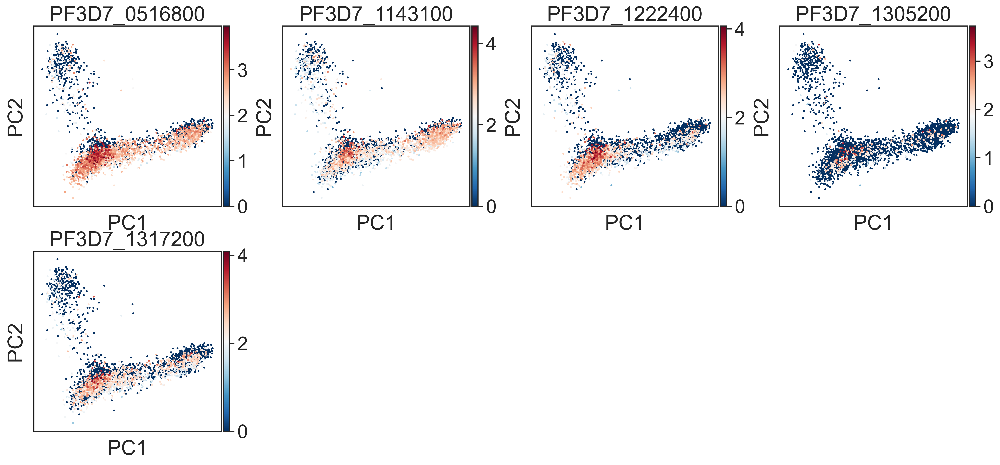

In [220]:
TFs =['PF3D7_0516800', 'PF3D7_1143100', 'PF3D7_1222400', 'PF3D7_1305200', 'PF3D7_1317200']
sc.pl.pca(ad, color= TFs , cmap='RdBu_r', size =20, save = 'umapsTFs_umpas.png')

In [45]:
regulons = [r.rename(r.name.replace('(',' (')) for r in regulons]

In [318]:
export2loom(adata.to_df(), regulons, LOOM_FNAME,
            cell_annotations=adata.obs['cell_class'].to_dict(),
            auc_mtx = auc_mtx,
            tree_structure=(),
            nomenclature="Single_cell-gametocyte", auc_thresholds=thresholds,
            compress=False)

In [139]:
#TF to target genes expression profiles
TF_PF3D7_1305200 = [x.strip() for x in open('TF_PF3D7_1305200_tgenes.txt')]
TF_PF3D7_0516800 = [x.strip() for x in open('TF_PF3D7_0516800_tgenes.txt')]
TF_PF3D7_1222400 = [x.strip() for x in open('TF_PF3D7_1222400_tgenes.txt')]
TF_PF3D7_1143100 = [x.strip() for x in open('TF_PF3D7_1143100_tgenes.txt')]
TF_PF3D7_1317200 = [x.strip() for x in open('TF_PF3D7_1317200_tgenes.txt')]

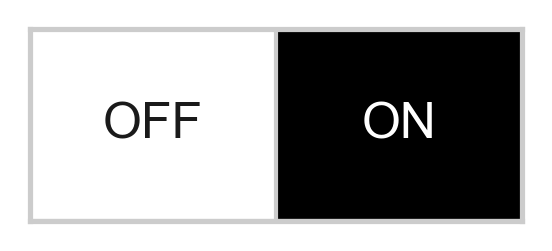

In [194]:
sns.set()
sns.set_style("whitegrid")
fig = palplot(bw_palette, ['OFF', 'ON'], ['k', 'w'])
fig.savefig('Legend.png', format='png')

In [99]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot(sns.color_palette(COLORS), adata.obs.annotation.dtype.categories, size=1)
fig.savefig('clusters-legend.png', format='png')

NameError: name 'COLORS' is not defined

In [43]:
#get the thershold and the bin
auc_mtx_unsorted = auc_mtx
auc_mtx_unsorted['annotation']=adata.obs['annotation']
auc_mtx_unsorted.sort_values(by='annotation', inplace=True)
auc_mtx=auc_mtx_unsorted.drop('annotation', axis=1)
binary_mtx, thresholds = binarize(auc_mtx)

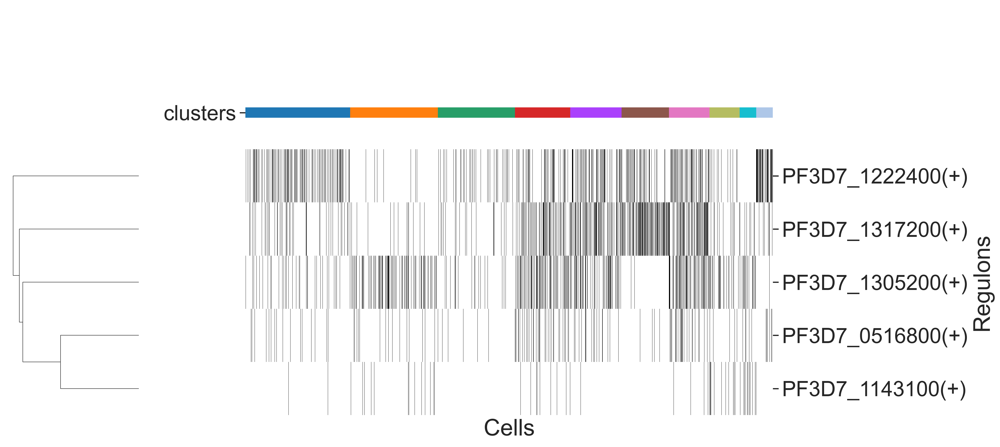

In [180]:
sns.set()
sns.set(font_scale=2.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(binary_mtx.T, method="single", col_cluster=False, row_cluster=True,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(15,7))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['clusters'])
g.cax.set_visible(False)
g.fig.savefig('clustermap_clusters annot- Regulons_V1.png', format='png')

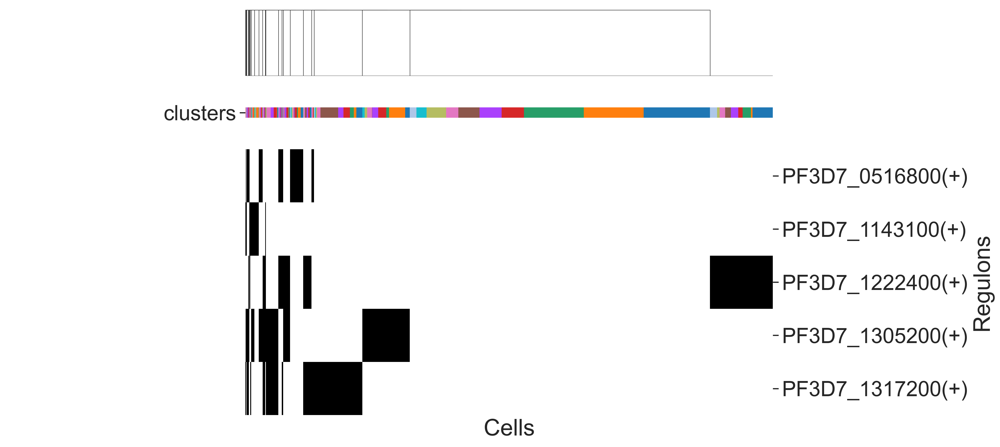

In [193]:
sns.set()
sns.set(font_scale=2.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(binary_mtx.T, method="single", col_cluster=True, row_cluster=False,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(15,7))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['clusters'])
g.cax.set_visible(False)
g.fig.savefig('clustermap_clusters annot- Regulons.png', format='png')

In [181]:
rss = regulon_specificity_scores(auc_mtx, adata.obs.annotation)
rss

,PF3D7_0516800(+),PF3D7_1143100(+),PF3D7_1222400(+),PF3D7_1305200(+),PF3D7_1317200(+)
C0,0.215588,0.208405,0.262107,0.323683,0.270509
C5,0.198797,0.183521,0.220759,0.250373,0.232902
C8,0.186332,0.181797,0.196730,0.206635,0.197768
C2,0.211710,0.188329,0.243783,0.296662,0.254328
C3,0.208882,0.189200,0.228433,0.265749,0.236860
C6,0.202011,0.180646,0.214799,0.244318,0.233740
C4,0.211166,0.185665,0.232615,0.256922,0.233232
C7,0.192903,0.183456,0.211093,0.226650,0.215579
C9,0.186101,0.179882,0.197163,0.204114,0.197205
C1,0.225685,0.188556,0.243891,0.294442,0.266696
